**데.멘.토 ) 푸잇 팀 : 이다현, 이지예, 한승민**

* 구글 Colab 환경에서 파일을 확인해주시기 바랍니다. 

**패키지 설치**

In [ ]:
!pip install chart_studio
!pip install cufflinks
!pip install folium
!pip install plotly
!pip install -U kaleido
!pip install kmodes

# 런타임 다시시작 

In [ ]:
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

import matplotlib as mpl
import matplotlib.pyplot as plt

plt.rc('font', family='NanumBarunGothic')

# 런타임 다시시작 및 재실행 

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**라이브러리 불러오기**

In [ ]:
# 기본 
import pandas as pd
import numpy as np 
import os 
import json
import seaborn as sns 
import matplotlib.pyplot as plt 

# 지도 시각화 
import folium
from folium import plugins
from folium.plugins import MarkerCluster

# 동적 시각화 
import chart_studio 
import plotly.graph_objects as go
from plotly.offline import iplot, init_notebook_mode 
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter
import plotly.express as px
import plotly.figure_factory as ff
from plotly.figure_factory._county_choropleth import create_choropleth
from plotly.subplots import make_subplots

def configure_plotly_browser_state(): ## Colab 환경에서 시각화 결과창 제시를 위한 함수 
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))
  
configure_plotly_browser_state()

init_notebook_mode(connected=False)

# 경고 문구 제거 
import warnings
warnings.filterwarnings(action='ignore')

# 클러스터링 
from sklearn.preprocessing import MinMaxScaler 
ms = MinMaxScaler()
from kmodes.kprototypes import KPrototypes


## ① 제안 배경 및 필요성 - 기부감소 현황 

In [ ]:
# 데이터 불러오기 
user = pd.read_csv("/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/user.csv", index_col = 0)
user_df = user.astype({"stdrYm":"object"})
user_df['year'] = user_df.stdrYm.astype(str).str[:4]

donate_trend = pd.read_csv("/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/donate.csv", index_col = 0)

In [ ]:
#2019년부터 2021년 이용자수와 기부자수 합치기
user_cnt = user_df[(user_df["year"]=='2019')|(user_df["year"]=='2020')|(user_df["year"]=='2021')].groupby("stdrYm")[["userCo"]].sum()
donate_cnt = donate_trend[(donate_trend["year"]==2019)|(donate_trend["year"]==2020)|(donate_trend["year"]==2021)].groupby("stdrYm")[["cntrbtrCo"]].sum()
total_cnt = pd.merge(user_cnt, donate_cnt, how="inner",on=["stdrYm"])
total_cnt.head()

,userCo,cntrbtrCo
stdrYm,,
201901,144446,6462
201902,135717,6039
201903,142486,6414
201904,154878,6476
201905,150164,6761


In [ ]:
#이용자수-기부자수 시각화하기

configure_plotly_browser_state()
init_notebook_mode(connected=False)

fig = make_subplots(specs=[[{"secondary_y": True}]])


fig.add_trace(go.Scatter(x=total_cnt.index.astype(str), y=total_cnt.userCo, mode='lines', 
                         name="이용자",marker=dict(color="#787878")), secondary_y=False,) 
fig.add_trace(go.Scatter(x=total_cnt.index.astype(str), y=total_cnt.cntrbtrCo, mode='lines',
                         name="기부자",marker=dict(color="#FD9F28")), secondary_y=True,)

fig.update_yaxes(title_text="이용자수", secondary_y=False)
fig.update_yaxes(title_text="기부자수", secondary_y=True)

fig.update_xaxes(tickangle=315,)

fig.update_layout(font=dict(family="Franklin Gothic",size=10)
                  ,plot_bgcolor="white",title_text="2019년~2021년 이용자수-기부자수 추이")

fig.show()

## ② 분석 내용 - 전국 단위 분석 

### ②-A. 지역별 코로나 전후 기부건수 증감률 

In [ ]:
# 데이터 불러오기 
donate_df = pd.read_csv("/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/donate.csv", index_col = 0)

In [ ]:
# 코로나 전후 비교를 위한 데이터 생성 

donate_df.rename(columns = {'cntrAmt' : '기부금액', 'cntrCo' : '기부건수', 'cntrbtrCo' : '기부자수'},inplace=True)
d_corona = donate_df[(donate_df['year']==2021) | (donate_df['year']==2019)] 
s = d_corona.groupby(['지역코드명','year']).agg({'기부금액' : 'mean', '기부건수' : 'sum', '기부자수' : 'sum'}).reset_index(level = [0,1]) 
s_ex = s.copy()

In [ ]:
# 수치형 변수 스케일링 

scaler = MinMaxScaler() 
s_ex[['기부건수','기부자수']] = scaler.fit_transform(s_ex[['기부건수','기부자수']]) 

In [ ]:
updown = pd.DataFrame() 
updown['지역'] = list(s_ex.지역코드명.unique())

ud_list = []

for i in list(s_ex.지역코드명.unique()) : 

  a = s_ex[(s_ex['지역코드명'] == i) & (s_ex['year'] == 2021)]['기부건수'].values
  b = s_ex[(s_ex['지역코드명'] == i) & (s_ex['year'] == 2019)]['기부건수'].values
  ud_list.append(float((a-b)/b * 100)) # 증감률 계산 

updown['증감률'] = ud_list

updown['p_m'] = ' '
for j in range(len(updown)) : 
  if updown['증감률'][j] < 0 : 
    updown['p_m'][j] = '감소'
  else : 
    updown['p_m'][j] = "증가"

updown.loc[updown['지역'] == '서울','p_m'] = "서울" 
updown.drop(15, inplace=True)
updown = updown.sort_values(by='증감률')

In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)

bar_color = dict.fromkeys(updown['지역'],"#C2C2C2")
bar_color["서울"] = "#FFC57C"

fig = px.bar(updown, x = '지역', y = '증감률',  color=updown['지역'],
             color_discrete_map = bar_color )

fig.update_layout(title='전국 코로나 전후 기부건수 증감률',plot_bgcolor="white")

iplot(fig)

### ②-B. 푸드뱅크 주 이용자와 인구 통계 정보 비교

**1.2021년 이용자구분코드 비율 파이차트**

In [ ]:
#2021년 데이터만 가져오기
user_sp_ratio = user_df[user_df["year"]=="2021"]

In [ ]:
df_sp_ratio = user_sp_ratio.groupby("이용자구분코드명")[["userCo"]].sum()

#차트 색 지정
configure_plotly_browser_state()
init_notebook_mode(connected=False)
pie_color = dict.fromkeys(df_sp_ratio.index,"#C2C2C2")
pie_color["기초생활보장수급자"] = "#FFC57C"
pie_color["차상위계층"] = "#FFC57C"


fig = px.pie(df_sp_ratio , values = "userCo",names = df_sp_ratio.index, 
             title = "2021년 이용자구분코드명별 이용자수", 
             width = 800, height = 800, hole=.3,
             color=df_sp_ratio.index,
             color_discrete_map =pie_color )
             
fig.update_traces(textposition="inside", textinfo='percent+label',
                  marker=dict(line=dict(color='white', width=1)))

**2.기초생활수급자&차상위계층 및 한부모가정 2021년 시도별 수**

* KOSIS 데이터

In [ ]:
kosis_vis = pd.read_csv("/content/drive/MyDrive/데.멘.토 /[최종 노트북 수합] 데멘토/사용데이터/kosis_vis.csv",encoding="cp949")
kosis_vis = kosis_vis.set_index("시도명")
kosis_vis 

,차상위2021,기초2021
시도명,,
충북,32195.666670,76619
강원,37193.833330,84114
충남,38451.750000,84802
대전,31870.583330,72908
서울,153153.916700,402632
경기,187561.833300,422615
제주,14735.166670,32446
전남,55426.000000,101475
울산,16924.000000,38575


In [ ]:
#차트 색 지정
configure_plotly_browser_state()
init_notebook_mode(connected=False)
pie_color = dict.fromkeys(kosis_vis.index,"#C2C2C2")
pie_color["서울"] = "#FFC57C"

fig = px.pie(kosis_vis , values = "차상위2021",names = kosis_vis.index, 
             title = "2021년 기초생활보장수급자 시도별 비율", 
             width = 800, height = 800, hole=.3, color=kosis_vis.index,
             color_discrete_map =pie_color )

fig.update_traces(textposition="inside", textinfo='percent+label',
                  marker=dict(line=dict(color='white', width=0.5)))

In [ ]:
#차트 색 지정
configure_plotly_browser_state()
init_notebook_mode(connected=False)
pie_color = dict.fromkeys(kosis_vis.index,"#C2C2C2")
pie_color["서울"] = "#FFC57C"

fig = px.pie(kosis_vis , values = "기초2021",names = kosis_vis.index, 
             title = "2021년 차상위계층 및 한부모가정 시도별 비율", 
             width = 800, height = 800, hole=.3, color=kosis_vis.index,
             color_discrete_map =pie_color )

fig.update_traces(textposition="inside", textinfo='percent+label',
                  marker=dict(line=dict(color='white', width=0.5)))

### ②-C. 기부 어플 서비스 진행시 기부 물품 종류 다양성 확보

In [ ]:
#전국 기부물품 분포 현황
supply=pd.read_csv('/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/supply.csv')
supply['stdrYm']=supply['stdrYm'].astype('str')
supply['year']=supply['stdrYm'].str[:4]
supply['month']=supply['stdrYm'].str[4:]

supply_need=supply[['기부물품대분류코드명','기부물품중분류명','지역코드명','provdCo','year']]
mask=supply_need['지역코드명'].isin(['중앙물류'])
supply_need=supply_need[~mask]
mask=supply_need['지역코드명'].isin(['중앙'])
supply_need=supply_need[~mask]
supply_2021=supply_need.query('year=="2021"')

In [ ]:
test=supply_2021.groupby('기부물품대분류코드명')['provdCo'].sum()
test=test.rename('제공건수').reset_index()
test
test['비율(%)']=test['제공건수']/test['제공건수'].sum()*100
test['비율(%)']=test['비율(%)'].round(2)
test.sort_values(by='비율(%)',inplace=True,ascending=False)
test.drop('제공건수',axis=1)

,기부물품대분류코드명,비율(%)
0,가공식품,80.02
8,일상용품,8.11
5,신선식품,6.87
1,가정용품,3.40
6,의류/패션잡화,0.98
3,문화용품,0.28
7,의약품/의료용품,0.27
4,스포츠용품,0.04
2,내구소비재,0.03


In [ ]:
#전국 기부물품 하위권 분포
test_2021=supply_2021[['기부물품대분류코드명','provdCo','지역코드명']]
test=test_2021.groupby(['지역코드명','기부물품대분류코드명'])['provdCo'].agg('sum')
test=test.rename('제공건수').reset_index()
test.to_excel('fixed.xlsx') # 추후 전처리 작업은 엑셀로 진행하였으며, 지역 기준으로 기부물품대분류코드명, 제공건수, 비율을 구하였다.

In [ ]:
#엑셀로 전처리한 하위권 물품 분포 데이터는 bottom_prodcut로 지정하였다.
bottom_product=pd.read_excel('/content/drive/MyDrive/데.멘.토 /[최종 노트북 수합] 데멘토/사용데이터/bottom_product.xlsx')
bottom_product=bottom_product.set_index('지역')
bottom_product

,내구소비재,문화용품,스포츠용품
지역,,,
강원,50.402576,49.597424,0.000000
경기,15.151515,83.666857,1.181628
경남,7.377049,92.622951,0.000000
경북,22.707424,77.292576,0.000000
광주,0.000000,100.000000,0.000000
대구,9.615385,90.384615,0.000000
대전,43.674912,56.325088,0.000000
부산,54.358974,45.641026,0.000000
서울,18.060351,37.359255,44.580393


In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)

scale = px.colors.sequential.Oranges

graph=px.bar(bottom_product, color_discrete_sequence=scale)
graph.update_layout(yaxis=dict({'title':'물품별 비중'}),plot_bgcolor="white", title = '전국 지역 하위권 기부물품 (1% 미만) 비율')

## ③ 서울 지역 문제점 도출

### ③-A.선호도를 반영한 기부 자원 확보

In [ ]:
# 2019 선호물품기부현황 
supply=pd.read_csv('/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/supply.csv')
supply['stdrYm']=supply['stdrYm'].astype('str')
supply['month']=supply['stdrYm'].str[4:]
supply['year']=supply['stdrYm'].str[:4]


supply_2019=supply.query('year=="2019"')
supply_2019=supply.query('지역코드명=="서울"')

In [ ]:
supply_2019=supply_2019[['기부물품대분류코드명','provdCo']]
pd.set_option('display.float_format','{:,.2f}'.format)
supply_2019=supply_2019.groupby('기부물품대분류코드명').aggregate({'provdCo':'sum'}).reset_index()
supply_2019

,기부물품대분류코드명,provdCo
0,가공식품,10382937
1,가정용품,609326
2,내구소비재,11902
3,문화용품,27915
4,스포츠용품,6631
5,신선식품,1113033
6,의류/패션잡화,451100
7,의약품/의료용품,55326
8,일상용품,1498729


In [ ]:

# Use `hole` to create a donut-like pie chart
configure_plotly_browser_state()
init_notebook_mode(connected=False)

pie_color = dict(zip(supply_2019['기부물품대분류코드명'],
                          ['#FFC57C','#C2C2C2', '#C2C2C2','#C2C2C2','#C2C2C2','#FF9966','#C2C2C2','#C2C2C2','#C2C2C2']))


fig = px.pie(supply_2019, names = '기부물품대분류코드명', values= 'provdCo', hole=.3, title="선호물품 제공 현황(2019)",
             width = 900, height = 900, color = '기부물품대분류코드명',color_discrete_map = pie_color)

fig.show()

### ③-B. 기부 물품 편차

In [ ]:
#기부물품편중
receipt=pd.read_csv('/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/receipt.csv')
receipt=receipt.query('지역코드명=="서울"')
receipt['stdrYm']=receipt['stdrYm'].astype('str')
receipt['year']=receipt['stdrYm'].str[:4]
receipt['month']=receipt['stdrYm'].str[4:]
receipt_2021=receipt.query('year=="2021"')
receipt_2021=receipt_2021[['기부물품대분류코드명','통합시군구명','cntrbtrCo','cntrCo']]
a=receipt_2021[['기부물품대분류코드명','cntrbtrCo','cntrCo']]
a=a.groupby(['기부물품대분류코드명'])['cntrbtrCo','cntrCo'].sum().reset_index()
a['개수']=a['cntrCo']/a['cntrbtrCo'].round(1)
a

,기부물품대분류코드명,cntrbtrCo,cntrCo,개수
0,가공식품,16603,148821,8.96
1,가정용품,451,696,1.54
2,내구소비재,18,24,1.33
3,문화용품,44,90,2.05
4,스포츠용품,2,2,1.00
5,신선식품,1005,2498,2.49
6,의류/패션잡화,244,347,1.42
7,의약품/의료용품,58,82,1.41
8,일상용품,739,1359,1.84


In [ ]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)

bar_color = dict.fromkeys(a['기부물품대분류코드명'],"#FFC57C")
graph=px.bar(a,x='기부물품대분류코드명',y='개수', color=a['기부물품대분류코드명'],
             color_discrete_map = bar_color )
graph.update_layout(plot_bgcolor="white",title ='물품 종류별 1인당 연평균 기부물품 건수')
graph.show()

## ④ 기부 활성화 방안 도출 

### ④-A. 클러스터링 기반 기부자-센터 매칭 서비스

In [ ]:
supply_df = pd.read_csv('/content/drive/MyDrive/데.멘.토 /서울데이터/file/supply.csv',index_col=0)
supply_2021 = supply_df[supply_df['year'] == 2021] # (물품별) 이용자수, 제공건수 
supply_2021['month'] = supply_2021['stdrYm'].apply(lambda x : str(x)[4:])
s = supply_2021.drop(['stdrYm','센터코드명','year','spctrCd'],axis=1)

In [ ]:
numeric = ['provdCo','provdAmt','userCo'] # 수치형
cat = ['기부물품중분류명', '기부물품대분류코드명', '통합시군구명', 'foodYn','month'] # 범주형

s[numeric] = ms.fit_transform(s[numeric]) # MinMaxScaler 
catColumnsPos = [s.columns.get_loc(col) for col in cat] # 범주형 변수 인덱스 위치 지정 
print('Categorical columns           : {}'.format(cat))
print('Categorical columns position  : {}'.format(catColumnsPos))

Categorical columns           : ['기부물품중분류명', '기부물품대분류코드명', '통합시군구명', 'foodYn', 'month']
Categorical columns position  : [0, 1, 2, 3, 7]


In [ ]:
dfMatrix = s.to_numpy() # 행렬 형태로 변환 

In [ ]:
# 군집 개수 설정하기 

cost = [] 
for x in range(2,11):
    kprototype = KPrototypes(n_jobs = -1, n_clusters = x, init = 'Huang', random_state = 0)
    clusters = kprototype.fit_predict(dfMatrix, categorical = catColumnsPos)
    cost.append(kprototype.cost_)

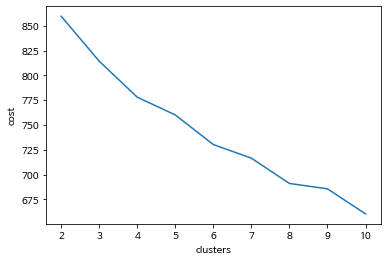

In [ ]:
# 군집 개수 결정 
df_cost = pd.DataFrame()
df_cost['clusters'] = range(2,11)
df_cost['cost'] = cost
sns.lineplot(x='clusters', y= 'cost', data=df_cost)

In [ ]:
kprototype = KPrototypes(n_jobs = -1, n_clusters = 4, init = 'Huang', random_state = 0)
clusters = kprototype.fit_predict(dfMatrix, categorical = catColumnsPos)

In [ ]:
s['cluster'] = clusters 
s['센터코드'] = supply_2021['spctrCd']

In [ ]:
s.cluster.value_counts()

3    4309
0    2574
1    2425
2    1430
Name: cluster, dtype: int64

In [ ]:
s['center'] = supply_2021['센터코드명']
s[numeric] = ms.inverse_transform(s[numeric])
df_1= s[s['cluster'] == 0]
df_2 = s[s['cluster'] == 1]
df_3 =  s[s['cluster'] == 2]
df_4 =  s[s['cluster'] == 3]

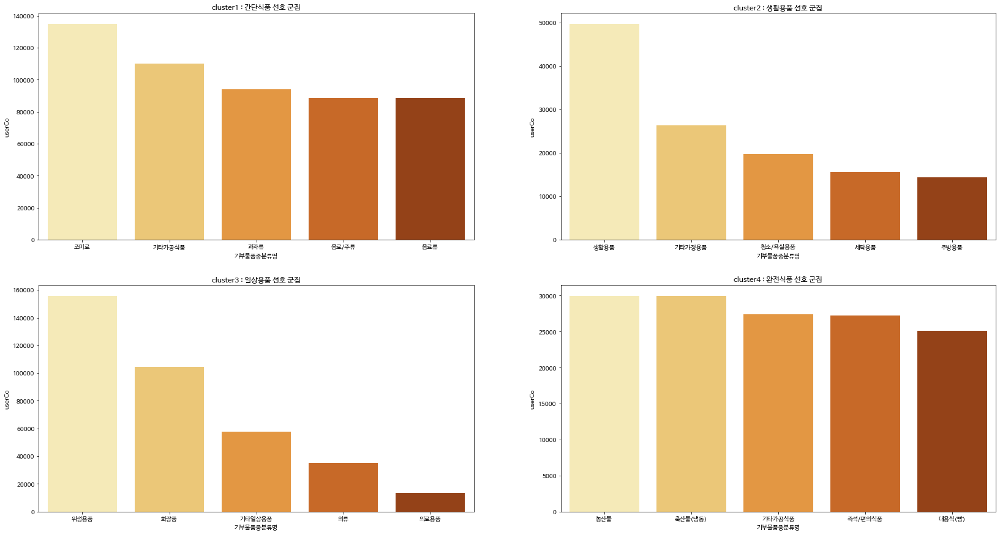

In [ ]:
# 기부물품 이용자수 합계 상위 5개 물품 결과 시각화 

table_1 = df_1.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
a = table_1.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)


table_2 = df_2.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
b = table_2.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)

table_3 = df_3.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
c = table_3.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)

table_4 = df_4.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
d = table_4.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)



plt.figure(figsize=(28,15)) 
plt.subplot(2, 2, 1)
sns.barplot(x = '기부물품중분류명', y = 'userCo', data = a, palette = 'YlOrBr')
plt.title('cluster1 : 간단식품 선호 군집')
plt.subplot(2, 2, 2)
sns.barplot(x = '기부물품중분류명', y = 'userCo', data = b, palette = 'YlOrBr')
plt.title('cluster2 : 생활용품 선호 군집')
plt.subplot(2, 2, 3)
sns.barplot(x = '기부물품중분류명', y = 'userCo', data = c, palette = 'YlOrBr')
plt.title('cluster3 : 일상용품 선호 군집')
plt.subplot(2, 2, 4)
sns.barplot(x = '기부물품중분류명', y = 'userCo', data = d, palette = 'YlOrBr')
plt.title('cluster4 : 완전식품 선호 군집')
plt.show()

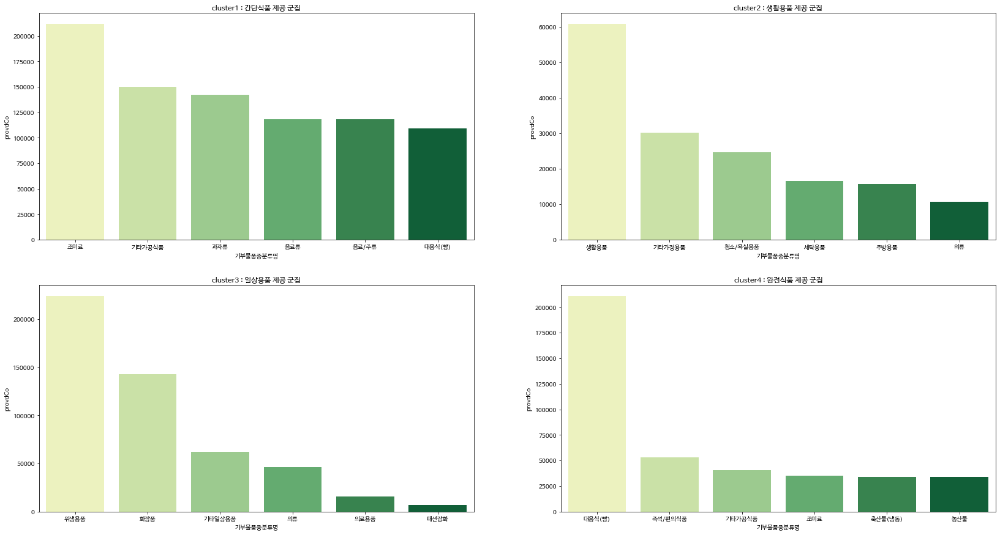

In [ ]:
# 군집별 주 제공 기부물품 살펴보기

table_1 = df_1.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
a = table_1.groupby(['기부물품중분류명']).agg({'provdCo' : 'sum','userCo' : 'sum'}).sort_values(by = 'provdCo',ascending=False)[:6].reset_index(level = 0)


table_2 = df_2.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
b = table_2.groupby(['기부물품중분류명']).agg({'provdCo' : 'sum','userCo' : 'sum'}).sort_values(by = 'provdCo',ascending=False)[:6].reset_index(level = 0)

table_3 = df_3.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
c = table_3.groupby(['기부물품중분류명']).agg({'provdCo' : 'sum','userCo' : 'sum'}).sort_values(by = 'provdCo',ascending=False)[:6].reset_index(level = 0)

table_4 = df_4.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3])
d = table_4.groupby(['기부물품중분류명']).agg({'provdCo' : 'sum','userCo' : 'sum'}).sort_values(by = 'provdCo',ascending=False)[:6].reset_index(level = 0)



plt.figure(figsize=(28,15)) 

plt.subplot(2, 2, 1)
sns.barplot(x = '기부물품중분류명', y = 'provdCo', data = a, palette = 'YlGn')
plt.title('cluster1 : 간단식품 제공 군집')
plt.subplot(2, 2, 2)
sns.barplot(x = '기부물품중분류명', y = 'provdCo', data = b, palette = 'YlGn')
plt.title('cluster2 : 생활용품 제공 군집')
plt.subplot(2, 2, 3)
sns.barplot(x = '기부물품중분류명', y = 'provdCo', data = c, palette = 'YlGn')
plt.title('cluster3 : 일상용품 제공 군집')
plt.subplot(2, 2, 4)
sns.barplot(x = '기부물품중분류명', y = 'provdCo', data = d, palette = 'YlGn')
plt.title('cluster4 : 완전식품 제공 군집')
plt.show()

In [ ]:
def recommend(spot, thing) : 

  # cluster1 

  table_1 = df_1.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3,4])
  a = table_1.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)
  cluster1_like = a.기부물품중분류명.values  # 군집별 가장 많은 이용 물품 Top5 리스트 

  # cluster2 

  table_2 = df_2.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3,4])
  b = table_2.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)
  cluster2_like = b.기부물품중분류명.values

  # cluster3

  table_3 = df_3.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3,4])
  c = table_3.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)
  cluster3_like = c.기부물품중분류명.values


  # cluster4

  table_4 = df_4.groupby(['통합시군구명','센터코드','기부물품대분류코드명','기부물품중분류명','center']).agg({'userCo' : 'sum', 'provdCo' : 'sum'}).reset_index(level = [0,1,2,3,4])
  d = table_4.groupby(['기부물품중분류명']).agg({'userCo' : 'sum'}).sort_values(by = 'userCo',ascending=False)[:5].reset_index(level = 0)
  cluster4_like = d.기부물품중분류명.values


  # 기부자가 입력한 물품에 따라 - 군집 table 매핑 

  if thing in cluster1_like : 
    like = cluster1_like
    df = table_1
  elif thing in cluster2_like : 
    like = cluster2_like
    df = table_2
  elif thing in cluster3_like : 
    like = cluster3_like
    df = table_3
  elif thing in cluster4_like : 
    like = cluster4_like
    df = table_4
  

  list_of_center = df[df['기부물품중분류명'].isin(like)].groupby(['통합시군구명','센터코드','center']).agg({'userCo' : 'mean'}).reset_index(level= [0,1,2]).sort_values(by='userCo',ascending=False)

  return list_of_center[list_of_center['통합시군구명'].isin(spot)] 
  # 기부자가 입력한 지역에 따라 - 군집 table center 필터링 

  


In [ ]:
recommend(['관악구','금천구','동작구'],'의류')

,통합시군구명,센터코드,center,userCo
16,동작구,S38101,동작구푸드뱅크·마켓센터,"3,421.25"
8,관악구,S38001,관악푸드뱅크마켓,"3,157.80"
11,금천구,S35401,금천구푸드뱅크마켓센터,754.50
12,금천구,S64601,금천행복푸드뱅크,167.50


In [ ]:
recommend(['성동구','중랑구'],'과자류')

,통합시군구명,센터코드,center,userCo
20,성동구,S35601,성동희망푸드나눔센터,"3,653.40"
30,중랑구,S69801,중랑푸드마켓(면목점),"1,768.60"
29,중랑구,S32801,중랑푸드마켓·뱅크센터,"1,341.80"
19,성동구,S00201,서울시광역푸드뱅크,"1,077.50"


### ④-B. 지역별 기부 현황 대시보드 제공 

In [ ]:
#(1) 지역별 기부 금액 
seoul=pd.read_csv('/content/drive/MyDrive/데.멘.토 /서울병합/seoul.csv')
seoul['stdrYm']=seoul['stdrYm'].astype('str')
seoul['month']=seoul['stdrYm'].str[4:]

seoul_12=seoul.query('month=="12"')
seoul_12=seoul_12[['통합시군구명','d_기부금액','d_기부자수']]
pd.set_option('display.float_format','{:,.2f}'.format)
seoul_12=seoul_12.groupby('통합시군구명').aggregate({'d_기부금액':'sum','d_기부자수':'sum'})
seoul_12['기부금액평균']=seoul_12['d_기부금액']/seoul_12['d_기부자수']
seoul_12

,d_기부금액,d_기부자수,기부금액평균
통합시군구명,,,
강남구,"609,533,040.00",70.00,"8,707,614.86"
강동구,"85,381,435.00",59.00,"1,447,142.97"
강북구,"171,930,609.50",44.00,"3,907,513.85"
강서구,"328,712,291.00",75.00,"4,382,830.55"
관악구,"96,611,030.00",35.00,"2,760,315.14"
광진구,"136,826,281.00",103.00,"1,328,410.50"
구로구,"60,604,104.00",35.00,"1,731,545.83"
금천구,"338,937,370.00",41.00,"8,266,765.12"
노원구,"197,071,282.00",66.00,"2,985,928.52"


In [ ]:
#(2)
seoul_12=seoul.query('month=="12"')
seoul_count=seoul_12[['통합시군구명','개인물품이용건수','단체물품이용건수','d_기부건수']]
seoul_count.head()
seoul_count=seoul_count.fillna(0)
seoul_count['이용건수']=seoul_count['개인물품이용건수']+seoul_count['단체물품이용건수']
seoul_count=seoul_count[['통합시군구명','d_기부건수','이용건수']]
t=seoul_count.groupby('통합시군구명').agg({'이용건수':'sum','d_기부건수':'sum'})
t=t.reset_index()
t=t.rename(columns={'d_기부건수':'기부건수'})
t

,통합시군구명,이용건수,기부건수
0,강남구,"14,587.00",531.00
1,강동구,"9,488.00",792.00
2,강북구,"5,975.00",366.00
3,강서구,"10,217.00",922.00
4,관악구,"7,326.00",267.00
5,광진구,"3,506.00",469.00
6,구로구,"9,871.00",302.00
7,금천구,"3,066.00",332.00
8,노원구,"25,802.00",628.00
9,도봉구,"10,892.00",330.00


In [ ]:
#(3)
receipt_gang=receipt.query('통합시군구명=="강남구"')
receipt_gang=receipt_gang.query('year=="2021"')
receipt_gang=receipt_gang[['month','acntbkAmt']]
receipt_gang=receipt_gang.groupby('month')['acntbkAmt'].sum().reset_index()
receipt_gang.to_excel('강남구 기부금액.xlsx')#이 후 태블로 작업

In [ ]:
#(4)
supply_gang=supply.query('통합시군구명=="강남구"')
supply_gang=supply_gang.query('year=="2021"')
supply_gang=supply_gang.query('month=="12"')
supply_gang=supply_gang[['기부물품중분류명','provdCo']]
supply_gang=supply_gang.groupby('기부물품중분류명')['provdCo'].sum().reset_index()
supply_gang.to_excel('강남구 top5 제공 물품.xlsx')#이 후 태블로 작업

In [ ]:
#(5)
proc_like=pd.read_csv('/content/drive/MyDrive/데.멘.토 /시각화를 위한 데이터/csvf/proc_like.csv')
proc_like=proc_like.query('지역코드명=="서울"')
proc_like['선호물품명'].unique()
a=proc_like.query('통합시군구명=="강남구"')
a=a.groupby(['센터코드명','선호물품명'])['보유수량'].sum().reset_index()
a.to_excel('당일 선호물품 현황.xlsx')#이후 엑셀에서 데이터 전처리 후 태블로 작업 진행

### ④-C. 1동 1푸드마켓

#### 1. 양천구 시각화 과정

In [ ]:
elderly = user_df[(user_df["year"]=="2021")&(user_df["지역코드명"]=="서울")]
elderly_chart = elderly[elderly["이용자분류코드명"]=="독거어르신"].groupby("통합시군구명")['userCo'].sum()
elderly_chart = elderly_chart.sort_values(ascending=False)
elderly_chart

통합시군구명
양천구     9992
영등포구    7153
동대문구    6748
성북구     5957
마포구     5615
성동구     5183
강북구     4820
구로구     4442
종로구     4103
서대문구    3638
은평구     3326
송파구     2880
강남구     2695
서초구     2413
금천구     2331
중구      2027
용산구     1952
강서구     1763
동작구     1677
강동구     1665
도봉구     1399
광진구     1387
관악구     1231
노원구     1150
중랑구     1084
Name: userCo, dtype: int64

In [ ]:
#차트 색 지정
configure_plotly_browser_state()
init_notebook_mode(connected=False)

bar_color = dict.fromkeys(elderly_chart.index,"#C2C2C2")
bar_color[list(bar_color.keys())[0]] = "#FFC57C"

fig = px.bar(elderly_chart, x=elderly_chart.index, y='userCo',
             color=elderly_chart.index, color_discrete_map=bar_color)

fig.update_layout(go.Layout(title={'text':'2021 서울 독거어르신 이용자수 순위'}, 
                            xaxis={'title': {'text': '구 이름'}},
                            yaxis={'title': {'text': '이용자수'}}, 
                            plot_bgcolor="white"
                        ))

fig.show()

In [ ]:
#https://github.com/raqoon886님의 깃허브에서 시도 구분선 json 가져오기
!git clone https://github.com/raqoon886/Local_HangJeongDong.git

Cloning into 'Local_HangJeongDong'...
remote: Enumerating objects: 59, done.
remote: Counting objects: 100% (59/59), done.
remote: Compressing objects: 100% (43/43), done.
remote: Total 59 (delta 28), reused 44 (delta 16), pack-reused 0
Unpacking objects: 100% (59/59), done.


In [ ]:
os.chdir('./Local_HangJeongDong')

In [ ]:
with open('./hangjeongdong_서울특별시.geojson', 'r') as f:
    seoul_geo2 = json.load(f)

In [ ]:
#센터정보 가져오기
center_seoul_21 = pd.read_csv("/content/drive/MyDrive/데.멘.토 /[최종 노트북 수합] 데멘토/사용데이터/center_seoul_21.csv")
center_seoul_21.head()

,지역명,지역코드명,통합시군구명,시군구명,지원센터단위명,지원센터구분명,지원센터명,전화번호,주소,주소수정,Latitude,Longitude
0,서울,서울특별시,성동구,서울특별시 성동구,광역,푸드뱅크,서울시광역푸드뱅크,02-905-1377,서울특별시 성동구 자동차시장3길 64 (용답동 중랑물재생센터),서울특별시 성동구 자동차시장3길 64,37.56,127.06
1,서울,서울특별시,종로구,서울특별시 종로구,기초,푸드마켓,종로구 푸드뱅크마켓센터,02-2148-4102,서울 종로구 숭인1동 55-2 숭인1동주민센터 4층,서울특별시 종로구 지봉로 86,37.58,127.02
2,서울,서울특별시,중구,서울특별시 중구,기초,푸드마켓,중구 푸드뱅크마켓센터,02-2297-1377,서울특별시 중구 퇴계로 460 (신당동),서울특별시 중구 퇴계로 460,37.57,127.02
3,서울,서울특별시,용산구,서울특별시 용산구,기초,푸드마켓,용산구 푸드뱅크마켓센터,02-703-0129,서울특별시 용산구 한강대로 345 용산구 푸드마켓 (구 갈월파출소)(갈월동),서울특별시 용산구 한강대로 345,37.55,126.97
4,서울,서울특별시,성동구,서울특별시 성동구,기초,푸드마켓,성동희망푸드나눔센터,02-425-1377,서울특별시 성동구 고산자로 323 (마장동)201호,서울특별시 성동구 고산자로 323,37.57,127.04


In [ ]:
#복지시설 데이터 가져오기
facility_welfare = pd.read_csv("/content/drive/MyDrive/데.멘.토 /[최종 노트북 수합] 데멘토/사용데이터/facility_welfare.csv")
facility_welfare = facility_welfare.rename(columns={"x":"y","y":"x"}) #위경도 이름 변경
facility_welfare.head()

,id,lclas,mlsfc,id_poi,poi_nm,branch_nm,sub_nm,mcate_cd,mcate_nm,pnu,...,rd_cd,rd_nm,bld_num,y,x,grid_cd,lst_updt_dt,data_orgn,FILE_NAME,base_ymd
0,KCSSRPO21N000000001,장소,기타문화공간,347606,해돋이어린이집,NaN,NaN,20402,어린이집,2620011500101000002,...,"262,004,184,227.00",절영로7번길,4,129.04,35.09,마라404786,20210916170801,KT,KC_501_DMSTC_MCST_SSRFT_2021,20210916
1,KCSSRPO21N000000002,장소,기타문화공간,348547,방배어린이집,NaN,NaN,20402,어린이집,1165010100103210010,...,"116,504,163,255.00",방배로19길,36-8,126.99,37.49,다사551429,20210916170801,KT,KC_501_DMSTC_MCST_SSRFT_2021,20210916
2,KCSSRPO21N000000003,장소,기타문화공간,350372,지성어린이집,NaN,NaN,20402,어린이집,1154510300108320024,...,"115,454,151,065.00",독산로22길,44,126.91,37.45,다사477394,20210916170801,KT,KC_501_DMSTC_MCST_SSRFT_2021,20210916
3,KCSSRPO21N000000004,장소,기타문화공간,350663,동산어린이집,NaN,NaN,20402,어린이집,2726011900102410010,...,"272,604,238,104.00",달구벌대로652길,65-6,128.71,35.83,마마093601,20210916170801,KT,KC_501_DMSTC_MCST_SSRFT_2021,20210916
4,KCSSRPO21N000000005,장소,기타문화공간,351287,만승어린이집,NaN,NaN,20402,어린이집,4375037027105290020,...,"437,504,535,425.00",화랑2길,17,127.44,36.99,다바944883,20210916170801,KT,KC_501_DMSTC_MCST_SSRFT_2021,20210916


In [ ]:
#중복 위치 센터 확인하기위한 좌표 합치기
facility_welfare["loctest"] = facility_welfare['x'].astype(str)+","+facility_welfare['y'].astype(str)
facility_welfare["loctest"]

0         35.0933536079873,129.040611369666
1         37.4850890243948,126.993058822854
2         37.4531913371008,126.908672672041
3          35.8321854830775,128.71020305391
4         36.9933907632115,127.438050502347
                        ...                
172652    35.3156654631996,127.438890538203
172653     36.4545846200781,127.26490880482
172654    35.2241987433694,128.684494168385
172655    37.6428167759824,127.057625733766
172656    35.2583113410284,128.865052691411
Name: loctest, Length: 172657, dtype: object

In [ ]:
print("중복제거 전 서울 시설 개수 : ",len(facility_welfare[facility_welfare["sido_nm"]=="서울특별시"]["loctest"]))
print("중복제거한 서울 시설 개수 : ",facility_welfare[facility_welfare["sido_nm"]=="서울특별시"]["loctest"].nunique())

중복제거 전 서울 시설 개수 :  16163
중복제거한 서울 시설 개수 :  15288


In [ ]:
fct_seoul = facility_welfare[facility_welfare["sido_nm"]=="서울특별시"] 
fct_seoul = fct_seoul.drop_duplicates(['loctest'])
fct_seoul.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15288 entries, 1 to 172655
Data columns (total 28 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           15288 non-null  object 
 1   lclas        15288 non-null  object 
 2   mlsfc        15288 non-null  object 
 3   id_poi       15288 non-null  int64  
 4   poi_nm       15288 non-null  object 
 5   branch_nm    336 non-null    object 
 6   sub_nm       0 non-null      float64
 7   mcate_cd     15288 non-null  int64  
 8   mcate_nm     15288 non-null  object 
 9   pnu          15288 non-null  int64  
 10  sido_nm      15288 non-null  object 
 11  sgg_nm       15288 non-null  object 
 12  bemd_nm      15288 non-null  object 
 13  ri_nm        0 non-null      object 
 14  beonji       15288 non-null  object 
 15  badm_cd      15288 non-null  int64  
 16  hadm_cd      15288 non-null  int64  
 17  rd_cd        15066 non-null  float64
 18  rd_nm        15076 non-null  object 
 19  bld

In [ ]:
fct_test1 = fct_seoul[fct_seoul["mcate_nm"]=="구청"]
fct_test2 = fct_seoul[fct_seoul["mcate_nm"]=="노인정/노인회관"]
fct_test3 = fct_seoul[fct_seoul["mcate_nm"]=="주민센터"]

In [ ]:
map = folium.Map(
    location=[37.5188717,126.853733],
    zoom_start=30, 
)

folium.GeoJson(
    seoul_geo2, #여기다가 사용할 json파일명 입력
    name='동 구분 선'
).add_to(map)


# 레이어 적용을 위한 그룹 만들기
# 대표 그룹 만들기
fg1 = folium.FeatureGroup(name="구청")
fg1_cluster = MarkerCluster().add_to(fg1)

fg2 = folium.FeatureGroup(name="노인정/회관")
fg2_cluster = MarkerCluster().add_to(fg2)

fg3 = folium.FeatureGroup(name="주민센터")
fg3_cluster = MarkerCluster().add_to(fg3)

fg4 = folium.FeatureGroup(name="푸드뱅크")

for _, row in fct_test1.iterrows():
    folium.Marker(location=[row["x"], row["y"]], # 좌표
    popup=row["poi_nm"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="pink",icon='star', prefix="fa")
    ).add_to(fg1_cluster)

for _, row in fct_test2.iterrows():
    folium.Marker(location=[row["x"], row["y"]], # 좌표
    popup=row["poi_nm"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="blue",icon='star')
    ).add_to(fg2_cluster)

for _, row in fct_test3.iterrows():
    folium.Marker(location=[row["x"], row["y"]], # 좌표
    popup=row["poi_nm"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="green",icon='star')
    ).add_to(fg3_cluster)

for _, row in center_seoul_21.iterrows():
    folium.Marker(location=[row["Latitude"], row["Longitude"]], # 좌표
    popup=row["지원센터명"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="black",icon='home', prefix="fa")
    ).add_to(fg4)

map.add_child(fg1)
map.add_child(fg2)
map.add_child(fg3)
map.add_child(fg4)

map.add_child(folium.map.LayerControl())

map

#### 2. 서대문구 시각화 과정 

In [ ]:
teen = user_df[(user_df["year"]=="2021")&(user_df["지역코드명"]=="서울")]
teen_chart = teen[teen["이용자분류코드명"]=="결식아동"].groupby("통합시군구명")['userCo'].sum()
teen_chart = teen_chart.sort_values(ascending=False)
teen_chart

통합시군구명
서대문구    7755
강서구     3289
마포구     2405
동대문구     781
성동구      625
강남구      590
중랑구      579
강동구      428
관악구      356
노원구      292
금천구      236
영등포구     235
광진구      134
송파구      129
은평구      122
성북구      119
도봉구      109
동작구       50
중구        48
서초구       34
구로구       33
용산구       32
양천구       30
강북구       21
종로구        8
Name: userCo, dtype: int64

In [ ]:
#차트 색 지정
configure_plotly_browser_state()
init_notebook_mode(connected=False)

bar_color = dict.fromkeys(teen_chart.index,"#C2C2C2")
bar_color[list(bar_color.keys())[0]] = "#FFC57C"

fig = px.bar(teen_chart, x=teen_chart.index, y='userCo',
             color=teen_chart.index, color_discrete_map=bar_color)

fig.update_layout(go.Layout(title={'text':'2021 서울 결식아동 이용자수 순위'}, 
                            xaxis={'title': {'text': '구 이름'}},
                            yaxis={'title': {'text': '이용자수'}},
                            plot_bgcolor="white"
                        ))

fig.show()

In [ ]:
facility_youth = pd.read_csv("/content/drive/MyDrive/데.멘.토 /데이터/시설위치데이터/facility_youth.csv")
facility_youth.head()

,SN,USE_SPCE_NM,USE_SPCE_CL_NM,TELNO,HMPG_URL,RDNMADR,CTPR_NM,SIGNGU_NM,EMD_NM,위도,경도,RM
0,1,성덕반딧불 작은도서관,강의실,033-660-3273,NaN,강원 강릉시 강중길 55,강원도,강릉시,입암동,37.76,128.91,NaN
1,2,한국자산관리공사 강원지사,강의실,033-640-3417,NaN,강원 강릉시 경강로 2151,강원도,강릉시,옥천동,37.76,128.90,NaN
2,3,월대산 작은도서관,강의실,033-660-3273,NaN,강원 강릉시 성덕포남로 80-21,강원도,강릉시,입암동,37.76,128.92,NaN
3,4,어울림 작은도서관,강의실,033-660-3273,NaN,강원 강릉시 성덕포남로149번길 42,강원도,강릉시,포남동,37.76,128.91,NaN
4,5,강릉시청소년문화의집,회의실,033-640-5987,NaN,강원 강릉시 연곡면 연주로 224,강원도,강릉시,연곡면,37.87,128.83,NaN


In [ ]:
fct_y_s = facility_youth[facility_youth["CTPR_NM"]=="서울특별시"]
fct_y_s.head()

,SN,USE_SPCE_NM,USE_SPCE_CL_NM,TELNO,HMPG_URL,RDNMADR,CTPR_NM,SIGNGU_NM,EMD_NM,위도,경도,RM
604,616,성내1동자치회관,강의실,02-3425-7769,NaN,서울 강동구 성내로 13,서울특별시,강동구,성내동,37.53,127.12,NaN
605,617,강풀만화거리,회의실,02-3425-6136,NaN,서울 강동구 천호대로168가길 65-29,서울특별시,강동구,성내동,37.54,127.13,NaN
606,618,새재미에너지사랑방 신흥경로당,회의실,02-2627-1993,NaN,서울 금천구 금하로23길 155,서울특별시,금천구,시흥동,37.46,126.91,NaN
607,619,청춘삘딩,회의실,02-2627-2587,NaN,서울 금천구 시흥대로138길 10-11,서울특별시,금천구,독산동,37.47,126.90,NaN
608,620,한국전기안전공사 서울북부지사,회의실,063-716-2233,NaN,서울 도봉구 노해로67길 14,서울특별시,도봉구,창동,37.65,127.05,NaN


In [ ]:
#이름에 구청이 들어가는 경우 구청 데이터와 겹치기 때문에 제거
fct_y_s[(fct_y_s.USE_SPCE_NM.str.contains("구청"))]

,SN,USE_SPCE_NM,USE_SPCE_CL_NM,TELNO,HMPG_URL,RDNMADR,CTPR_NM,SIGNGU_NM,EMD_NM,위도,경도,RM
618,630,성동구청,기타,02-2286-5207,NaN,서울 성동구 고산자로 270,서울특별시,성동구,행당동,37.56,127.04,NaN
671,682,중구청소년수련관,유료,02-2250-0500~1,www.j-youth.org,서울시 중구 동호로5길19,서울특별시,중구,신당동,37.55,127.01,NaN
676,687,금천구청종합청사,강의실,02-2627-2832,www.geumcheon.go.kr/main/index/index001.jsp,서울특별시 금천구 시흥대로 73길 70,서울특별시,금천구,시흥동,37.46,126.90,NaN


In [ ]:
fct_y_s = fct_y_s.drop([618,676],axis=0)

In [ ]:
fct_y_s[(fct_y_s.USE_SPCE_NM.str.contains("구청"))]

,SN,USE_SPCE_NM,USE_SPCE_CL_NM,TELNO,HMPG_URL,RDNMADR,CTPR_NM,SIGNGU_NM,EMD_NM,위도,경도,RM
671,682,중구청소년수련관,유료,02-2250-0500~1,www.j-youth.org,서울시 중구 동호로5길19,서울특별시,중구,신당동,37.55,127.01,NaN


In [ ]:
#주민센터는 존재하지 않는 것으로 파악됨
fct_y_s[(fct_y_s.USE_SPCE_NM.str.contains("주민센터"))]

,SN,USE_SPCE_NM,USE_SPCE_CL_NM,TELNO,HMPG_URL,RDNMADR,CTPR_NM,SIGNGU_NM,EMD_NM,위도,경도,RM


In [ ]:
#위치 중복 센터 확인하기위한 좌표 합치기
fct_y_s["loctest"] =fct_y_s['위도'].astype(str)+","+fct_y_s['경도'].astype(str)
fct_y_s["loctest"]

604    37.5303003,127.1224424
605     37.535007,127.1287224
606    37.4569731,126.9073333
607    37.4721278,126.8992715
608    37.6522542,127.0493815
                ...          
677    37.5619429,126.9644696
678    37.6053453,126.9335807
679    37.5724163,126.9824791
680    37.5585967,126.9732661
681    37.5542316,126.9740458
Name: loctest, Length: 75, dtype: object

In [ ]:
print("중복제거 전 서울 시설 개수 : ",len(fct_y_s["loctest"]))
print("중복제거한 서울 시설 개수 : ",fct_y_s["loctest"].nunique())

중복제거 전 서울 시설 개수 :  75
중복제거한 서울 시설 개수 :  75


In [ ]:
import folium
from folium import plugins
from folium.plugins import MarkerCluster, HeatMap

map = folium.Map(
    location=[37.5831393,126.9364575],
    zoom_start=15, 
)

folium.GeoJson(
    seoul_geo2, #여기다가 사용할 json파일명 입력
    name='동 구분 선'
).add_to(map)

# 레이어 적용을 위한 그룹 만들기
# 대표 그룹 만들기
fg1 = folium.FeatureGroup(name="구청")
fg1_cluster = MarkerCluster().add_to(fg1)

fg2 = folium.FeatureGroup(name="청소년이용시설")
fg2_cluster = MarkerCluster().add_to(fg2)

fg3 = folium.FeatureGroup(name="주민센터")
fg3_cluster = MarkerCluster().add_to(fg3)

fg4 = folium.FeatureGroup(name="푸드뱅크")

for _, row in fct_test1.iterrows():
    folium.Marker(location=[row["x"], row["y"]], # 좌표
    popup=row["poi_nm"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="pink",icon='star', prefix="fa")
    ).add_to(fg1_cluster)

for _, row in fct_y_s.iterrows():
    folium.Marker(location=[row["위도"], row["경도"]], # 좌표
    popup=row["USE_SPCE_NM"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="yellow",icon='star')
    ).add_to(fg2_cluster)

for _, row in fct_test3.iterrows():
    folium.Marker(location=[row["x"], row["y"]], # 좌표
    popup=row["poi_nm"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="green",icon='star')
    ).add_to(fg3_cluster)

for _, row in center_seoul_21.iterrows():
    folium.Marker(location=[row["Latitude"], row["Longitude"]], # 좌표
    popup=row["지원센터명"], # 클릭시 표시될 popup 내용
    icon=folium.Icon(color="black",icon='home', prefix="fa")
    ).add_to(fg4)

map.add_child(fg1)
map.add_child(fg2)
map.add_child(fg3)
map.add_child(fg4)
map.add_child(folium.map.LayerControl())

map

# git

In [10]:
!git config --list

user.email=mininyong08@gmail.com
user.name=zzozzo
